<a href="https://colab.research.google.com/github/rmatrella/BirdsSound/blob/main/Explainability.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os, sys
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)
%cd "/content/drive/MyDrive/Marino_Matrella"
root = os.getcwd()

Mounted at /content/drive/
/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project


#Init

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras import layers
from keras.models import Model
import random as rn
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import matplotlib.cm as cm
import cv2
from google.colab.patches import cv2_imshow

Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.


In [ ]:
%run '/content/drive/MyDrive/CIDL project/Utilities.ipynb'

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project
tensor version is  2.14.0-dev20230629


In [ ]:
MODELS_FOLDER = os.path.join(root, 'birds/model/')
MODELS_FOLDER

'/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/model/'

In [ ]:
cnn_scratch = load_model(MODELS_FOLDER + '/Scratch/Scratch_4ex.h5')
vgg16 = load_model(MODELS_FOLDER + '/VGG16/VGG16_2ft_twoblocks.h5')
mobilenetv2 = load_model(MODELS_FOLDER + '/MobileNet/MobileNet_model13.h5')
resnet50 = load_model(MODELS_FOLDER + '/ResNet50/ResNet50_finetuning_2blocks.h5')

In [ ]:
DATASET_FOLDER = os.path.join(root, 'birds/dataset')
TRAIN_PATH = os.path.join(DATASET_FOLDER, 'train_audio_aug')
VAL_PATH = os.path.join(DATASET_FOLDER, 'validation')
TEST_PATH = os.path.join(DATASET_FOLDER, 'test')

#Functions

In [ ]:
def get_index_by_layer_name(model, layer_name):

  for index, layer in enumerate(model.layers):
      if layer.name == layer_name:
          return index

In [ ]:
def display_feature_maps(layer_names, activations, how_many_layers_to_show=None, how_many_layers_to_skip=0):
  """
  Display the activation maps of layers in a convolutional neural network.

  Args:
      layer_names (list): List of strings containing the names of layers corresponding to the activation maps to be displayed.
      activations (list): List of tensors representing the activation maps of layers corresponding to the layer names provided in layer_names.
      how_many_layers_to_show (int, optional): Maximum number of layers to display. If not specified, all layers will be shown. Default: None.
      how_many_layers_to_skip (int, optional): Number of layers to skip at the beginning. Useful if you want to start displaying layers from a specific position. Default: 0.
  """

  # Reduce the list of layer names and activations based on the display parameters
  layer_names = layer_names[how_many_layers_to_skip:]
  activations = activations[how_many_layers_to_skip:]

  count_layers = 0
  for layer_name, layer_activation in zip(layer_names, activations):

      count_layers += 1
      if how_many_layers_to_show: # not None
        if count_layers > how_many_layers_to_show:
          break

      # Number of features in the feature map
      n_features = layer_activation.shape[-1]

      # The feature map has shape (1, image_height, image_width, n_features)
      # but image_height = image_width
      size = layer_activation.shape[1]

      # Calculate the number of columns in the image grid
      n_cols = n_features // images_per_row

      # Create an empty grid to hold all the feature maps
      display_grid = np.zeros((size * n_cols, images_per_row * size))

      for col in range(n_cols):
          for row in range(images_per_row):
              channel_image = layer_activation[0,:, :, col * images_per_row + row]
              channel_image -= channel_image.mean() # remove the mean
              channel_image /= channel_image.std() # divide by the standard deviation
              # now we have a standard normal distribution with the 95% of the pixel values in the interval [-2,2]
              # we must multiply for 64 to get the interval [-128, 128]
              channel_image *= 64
              # now we can sum 128 to get the interval [0, 255]
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
              display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

      # Display the grid
      scale = 1. / size
      plt.figure(figsize=(scale * display_grid.shape[1],
                          scale * display_grid.shape[0]))
      plt.title(layer_name)
      plt.grid(False)
      plt.imshow(display_grid, aspect='auto', cmap='gray')

  plt.show()

#Image analysis

In [ ]:
# First image of the test set
test_img = os.path.join(TEST_PATH, 'abhori1/XC200798_3.png')
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/abhori1/XC200798_3.png


Dimensioni dell'immagine originale: 515 x 389


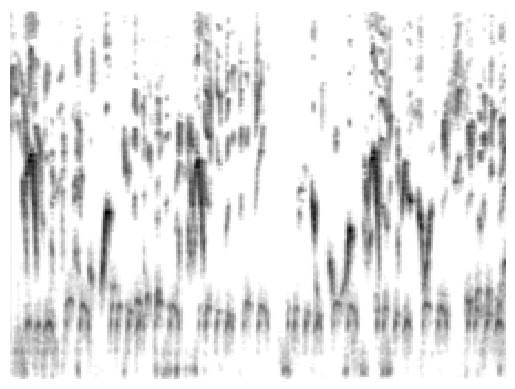

In [ ]:
img = Image.open(test_img)
width, height = img.size
print("Dimensioni dell'immagine originale: {} x {}".format(width, height))
img.show()

In [ ]:
# preprocess the image into a 4D tensor

img = image.load_img(test_img, target_size=(224, 224))
img_tensor = image.img_to_array(img)

img_tensor = np.expand_dims(img_tensor, axis=0)

print(img_tensor.shape)

(1, 224, 224, 3)


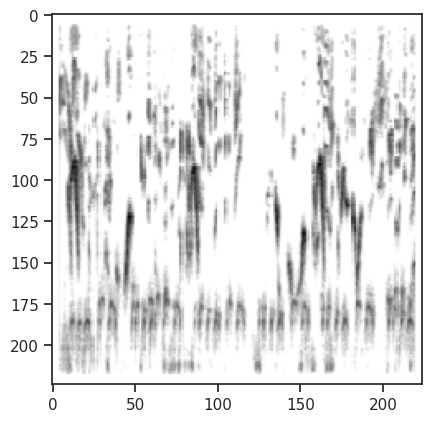

In [ ]:
plt.imshow(img_tensor[0].astype('uint8'))
plt.show()

#Layers activation

##CNN from scratch

Analysis of the best model obtaine with the CNN from scratch

In [ ]:
cnn_scratch.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                        

In [ ]:
layer_outputs = []
layer_names = []
for layer in cnn_scratch.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        print(layer.name)
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)

activation_model = keras.Model(inputs=cnn_scratch.input, outputs=layer_outputs) # one input and multiple outputs

conv2d
max_pooling2d
conv2d_1
max_pooling2d_1
conv2d_2
max_pooling2d_2
conv2d_3
max_pooling2d_3
conv2d_4


In [ ]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 0s 192ms/step
(1, 222, 222, 32)
(1, 111, 111, 32)
(1, 109, 109, 64)
(1, 54, 54, 64)
(1, 52, 52, 128)
(1, 26, 26, 128)
(1, 24, 24, 256)
(1, 12, 12, 256)
(1, 10, 10, 512)


In [ ]:
images_per_row = 16

Feature maps:

<ipython-input-8-e9f3ab64b7c9>:41: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std() # divide by the standard deviation


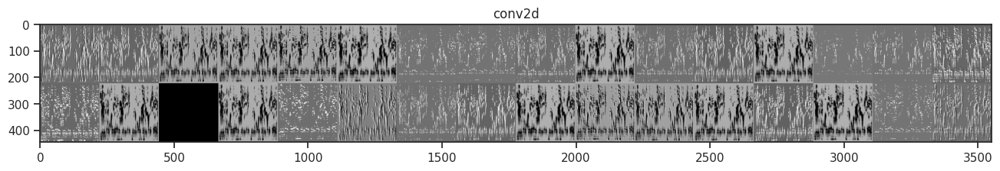

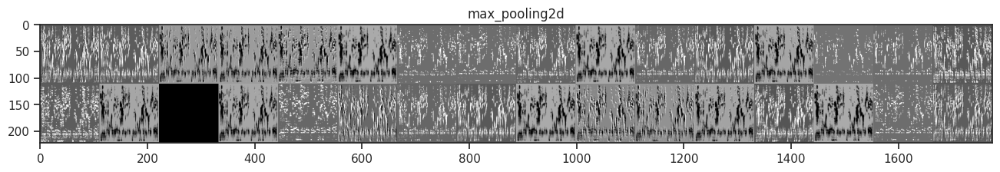

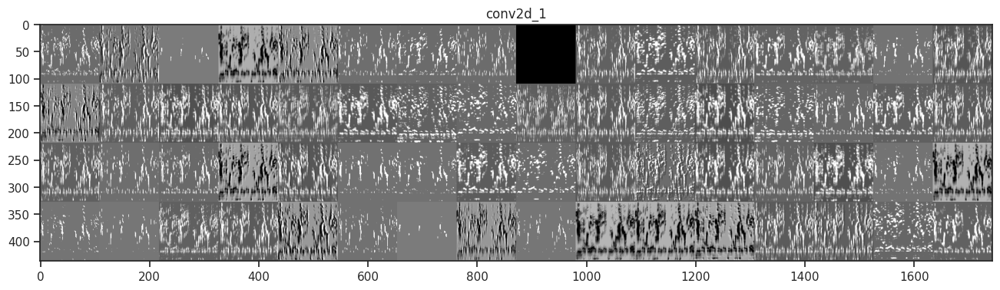

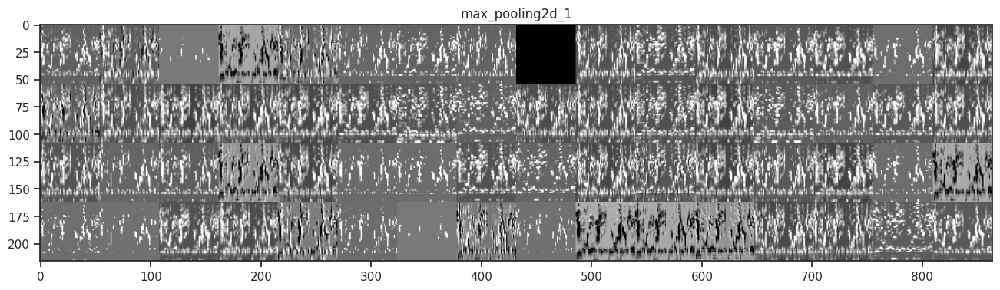

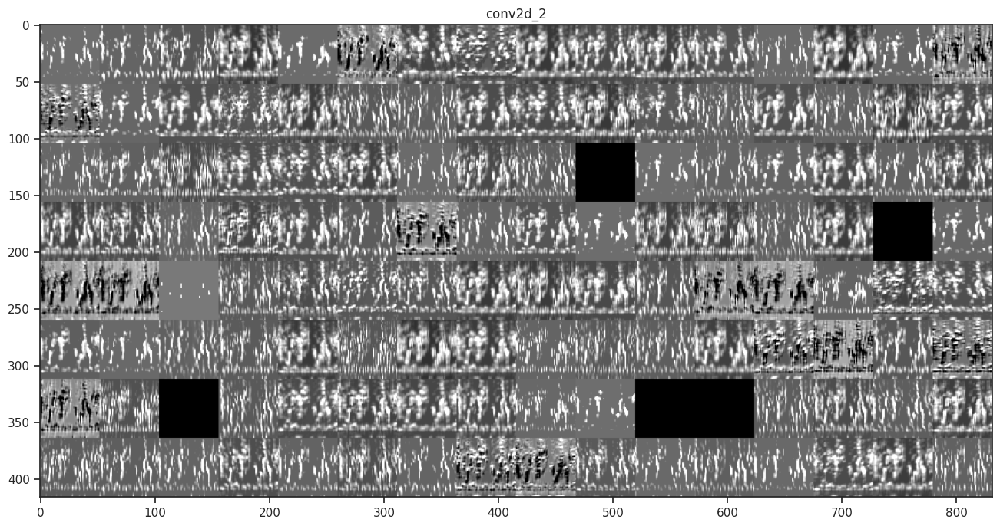

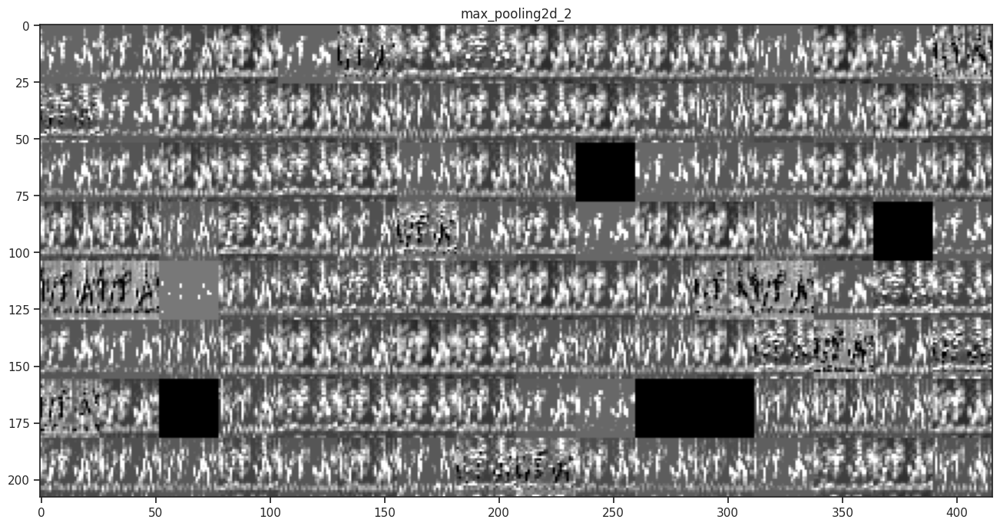

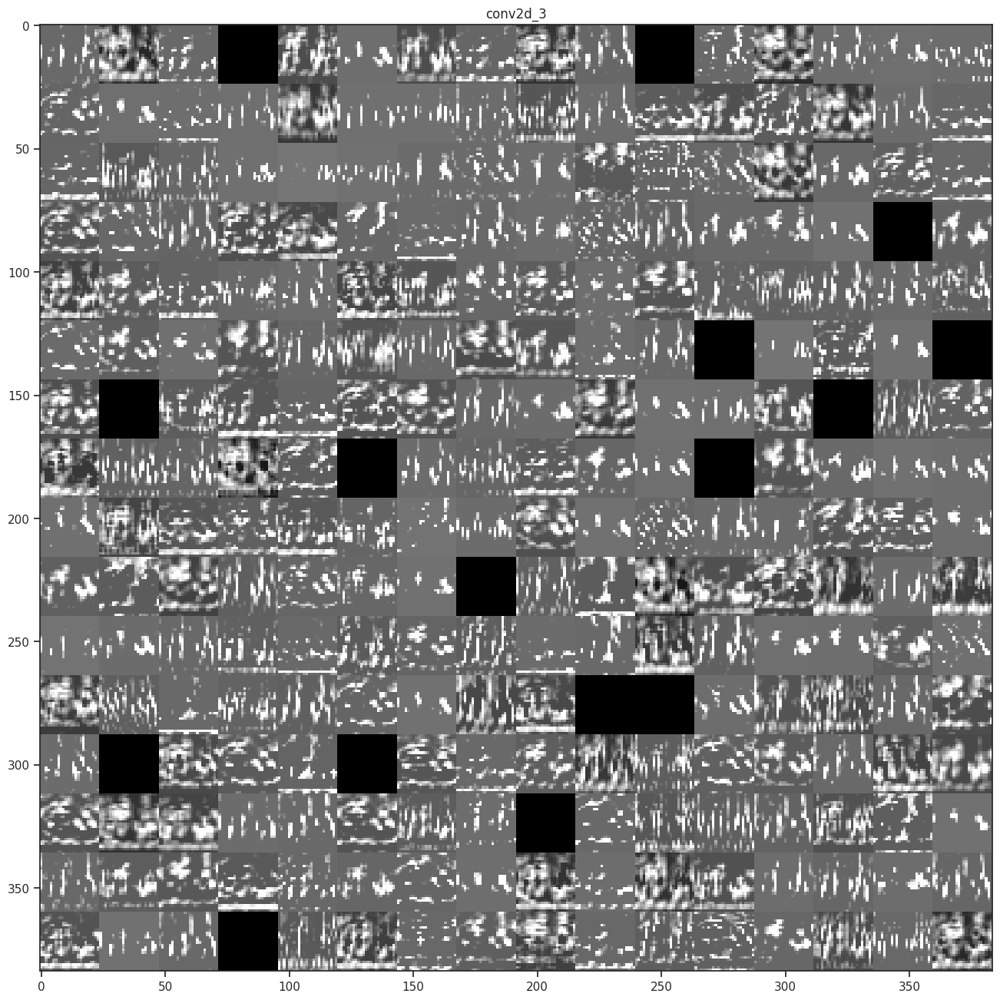

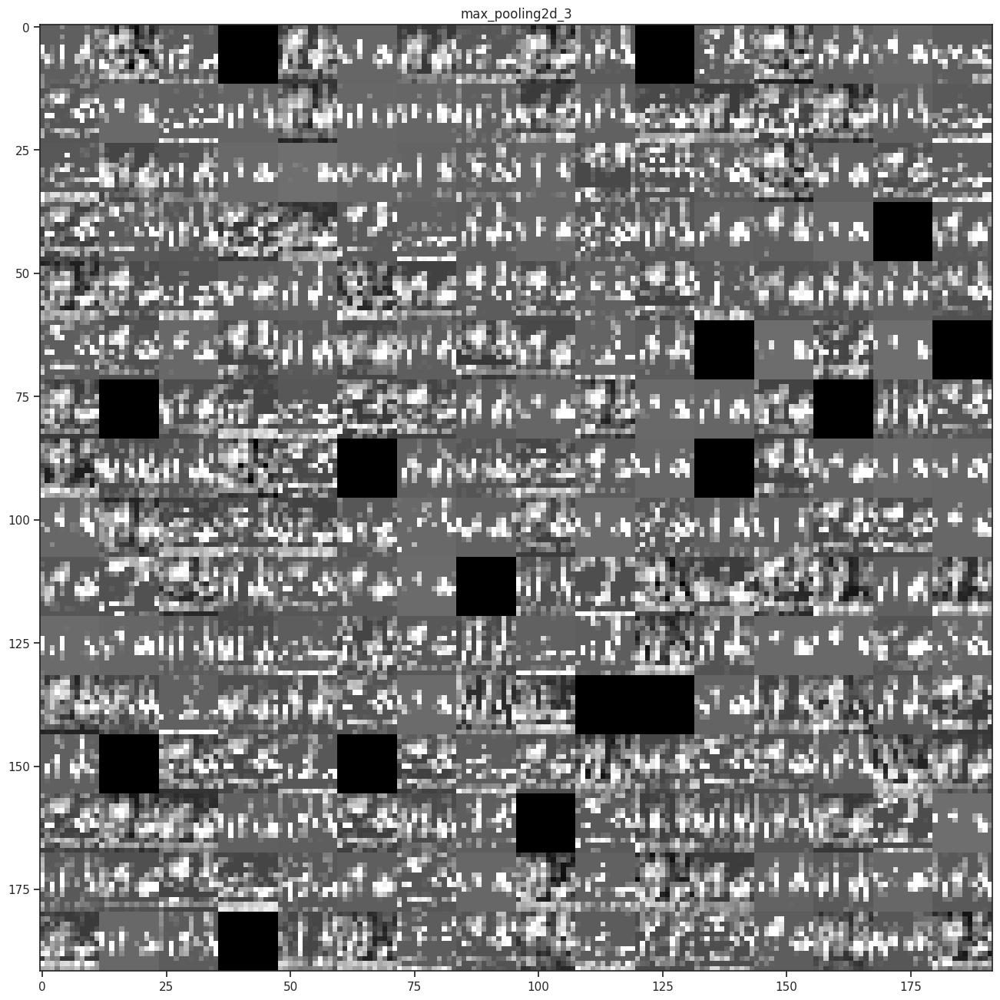

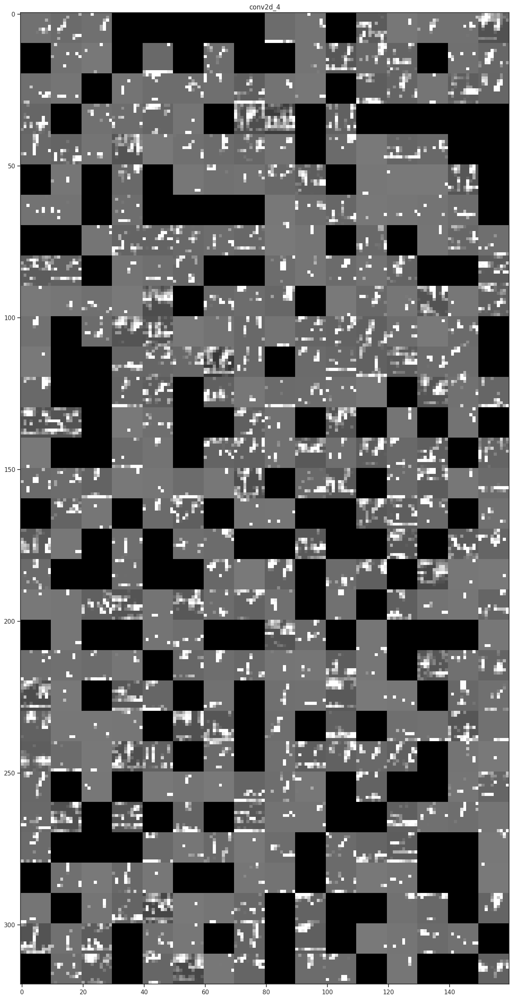

In [ ]:
display_feature_maps(layer_names, activations)

## VGG16

In [ ]:
vgg16.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.__operators__.getitem_1  (None, 224, 224, 3)       0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_1 (TFOpLamb  (None, 224, 224, 3)       0         
 da)                                                             
                                                                 
 base (Functional)           (None, 14, 14, 512)       7635264   
                                                                 
 global_average_pooling2d_1  (None, 512)               0         
  (GlobalAveragePooling2D)                                       
                                                           

In [ ]:
model = vgg16.get_layer('base')

In [ ]:
layer_outputs = []
layer_names = []
for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        print(layer.name)
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)

activation_model = keras.Model(inputs=model.input, outputs=layer_outputs) # one input and multiple outputs

block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_pool


In [ ]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 1s 1s/step
(1, 224, 224, 64)
(1, 224, 224, 64)
(1, 112, 112, 64)
(1, 112, 112, 128)
(1, 112, 112, 128)
(1, 56, 56, 128)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 28, 28, 256)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 14, 14, 512)


In [ ]:
images_per_row = 16

Feature maps:

<ipython-input-8-e9f3ab64b7c9>:41: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std() # divide by the standard deviation


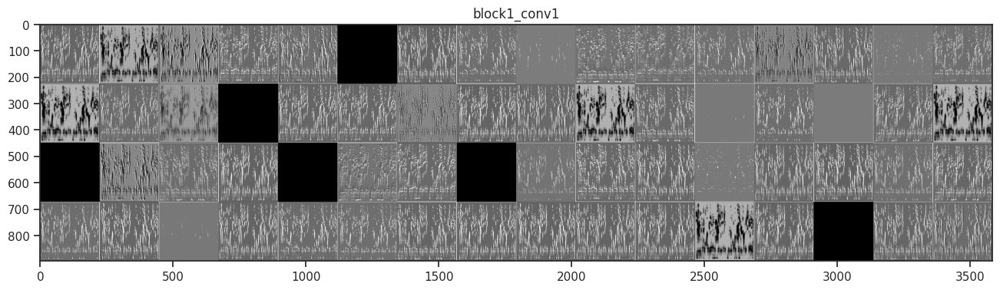

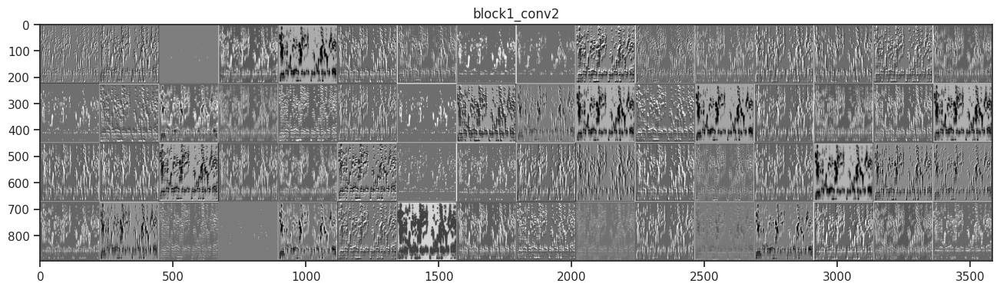

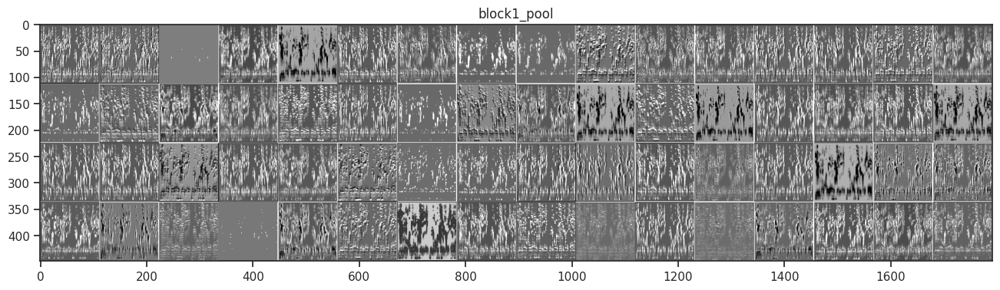

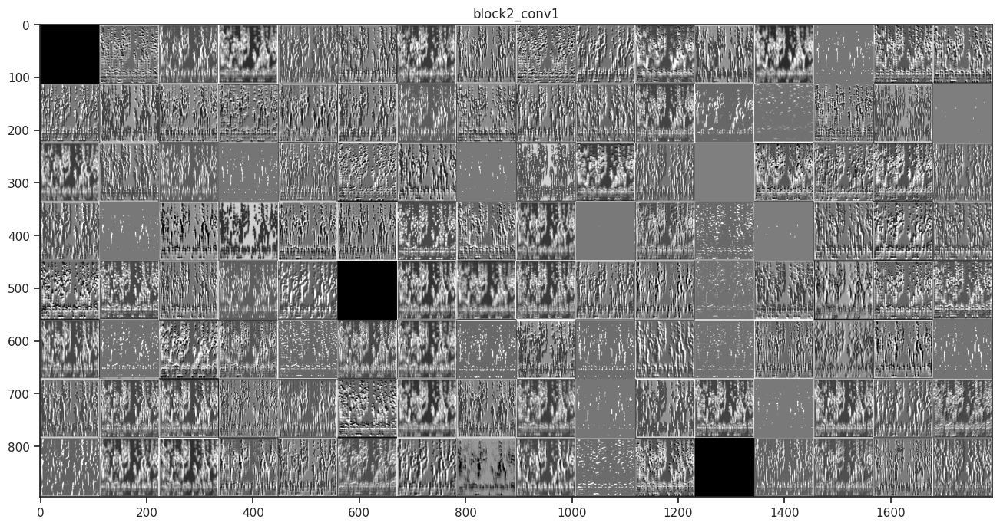

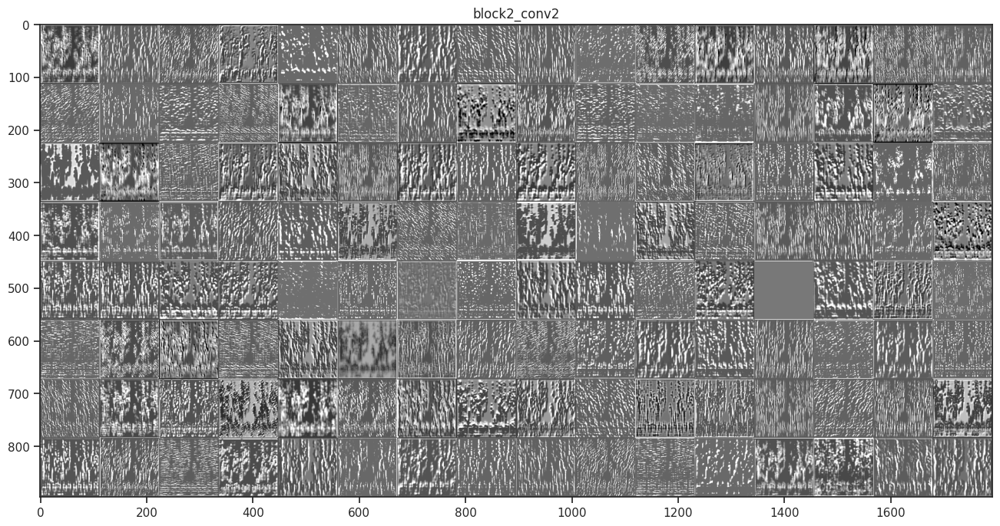

...

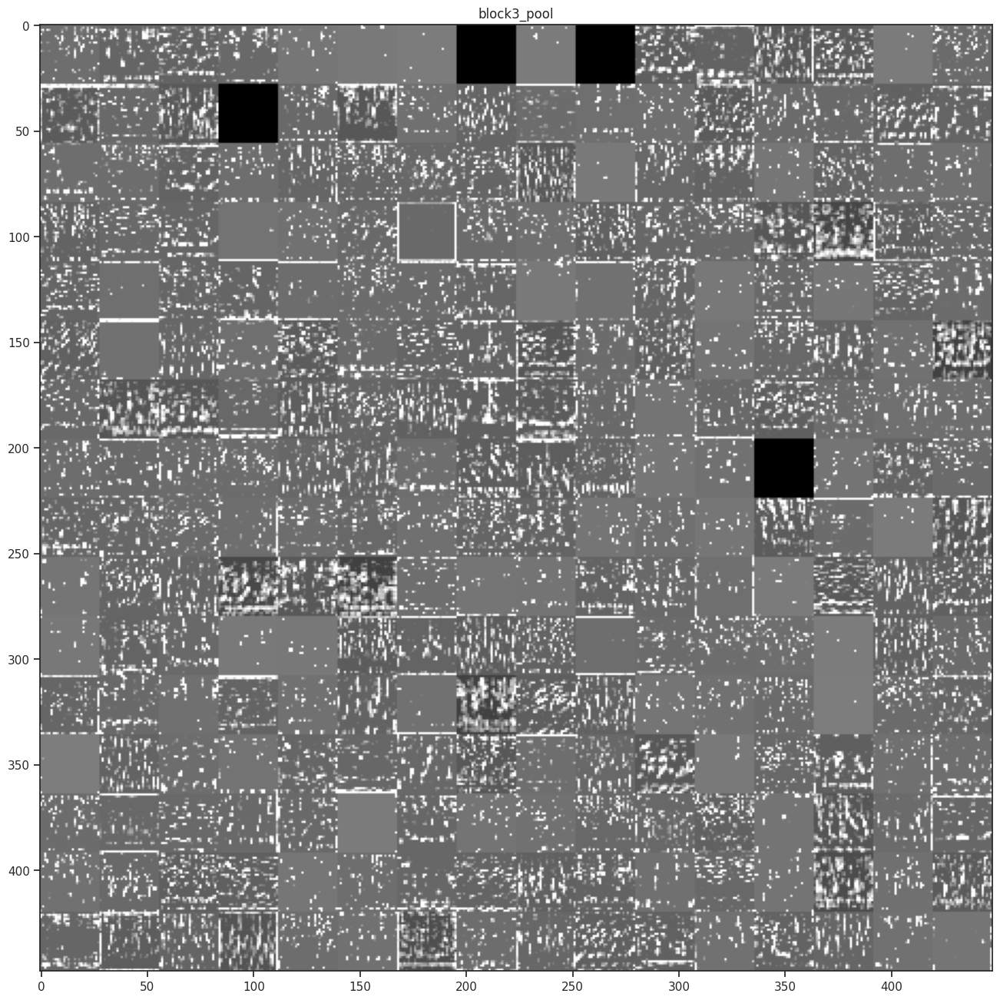

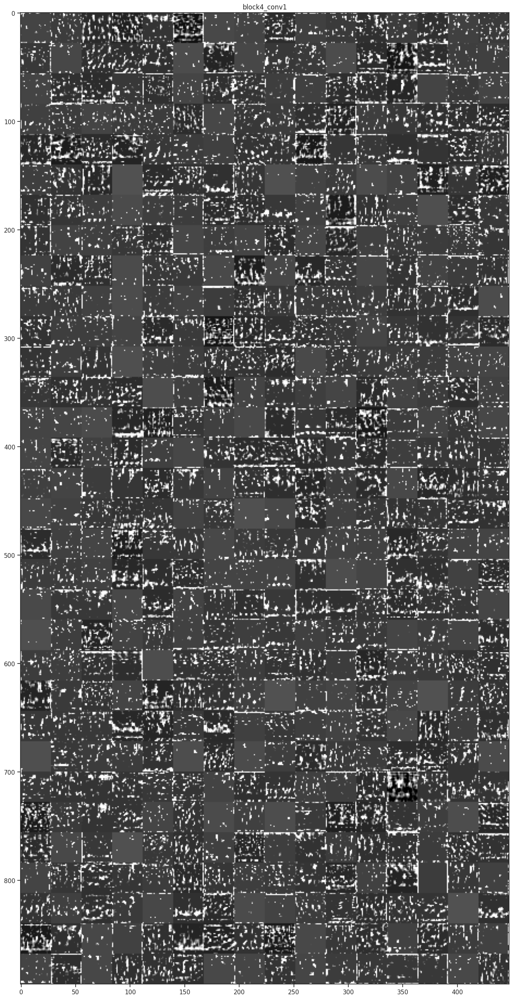

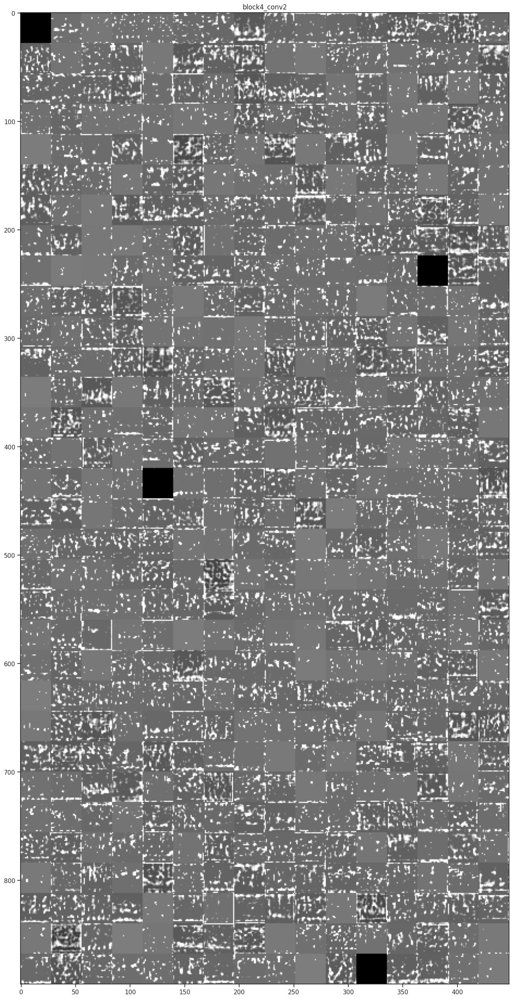

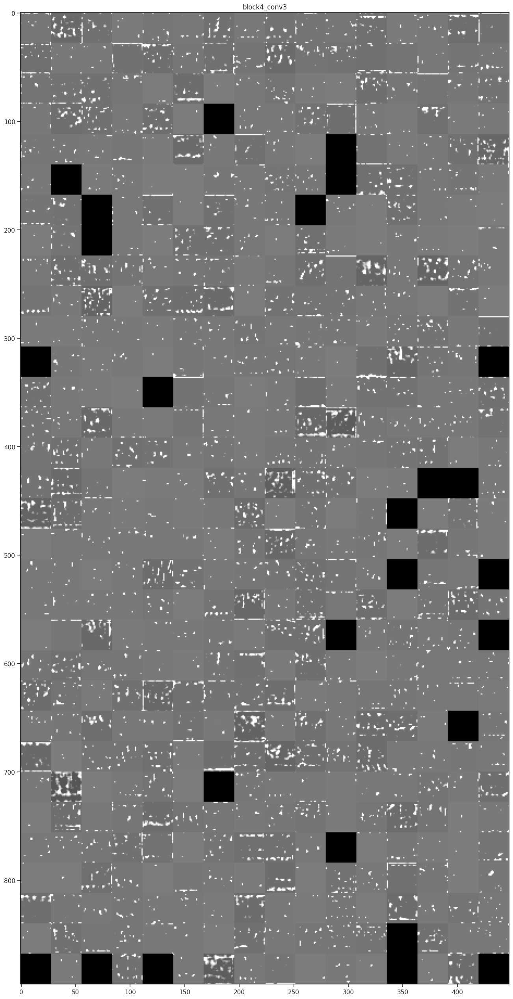

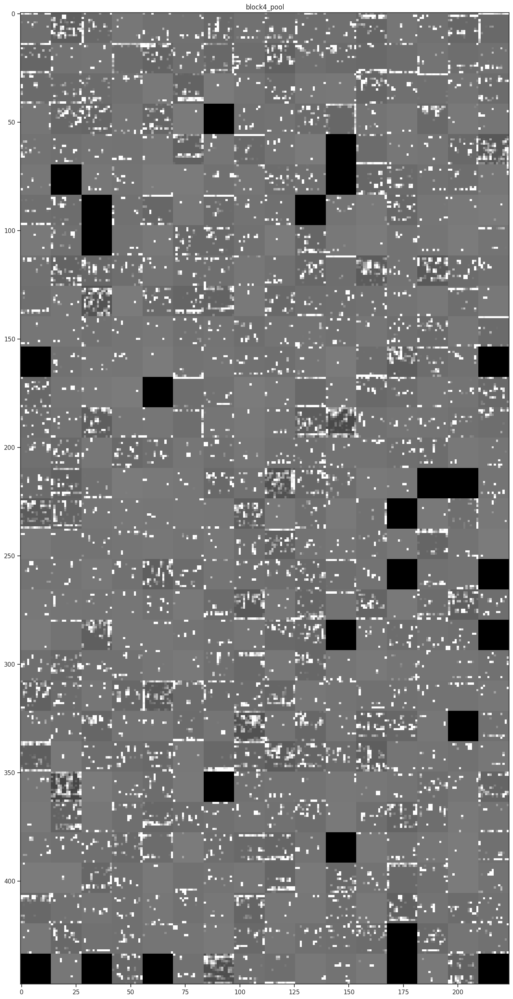

In [ ]:
display_feature_maps(layer_names, activations)

##MobileNetV2

In [ ]:
mobilenetv2.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambd  (None, 224, 224, 3)       0         
 a)                                                              
                                                                 
 tf.math.subtract (TFOpLamb  (None, 224, 224, 3)       0         
 da)                                                             
                                                                 
 base (Functional)           (None, 7, 7, 160)         1040704   
                                                                 
 global_average_pooling2d (  (None, 160)               0         
 GlobalAveragePooling2D)                                         
                                                             

In [ ]:
model = mobilenetv2.get_layer('base')

In [ ]:
layer_outputs = []
layer_names = []
for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        print(layer.name)
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)

activation_model = keras.Model(inputs=model.input, outputs=layer_outputs) # one input and multiple outputs

Conv1
expanded_conv_project
block_1_expand
block_1_project
block_2_expand
block_2_project
block_3_expand
block_3_project
block_4_expand
block_4_project
block_5_expand
block_5_project
block_6_expand
block_6_project
block_7_expand
block_7_project
block_8_expand
block_8_project
block_9_expand
block_9_project
block_10_expand
block_10_project
block_11_expand
block_11_project
block_12_expand
block_12_project
block_13_expand
block_13_project
block_14_expand
block_14_project


In [ ]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 3s 3s/step
(1, 112, 112, 32)
(1, 112, 112, 16)
(1, 112, 112, 96)
(1, 56, 56, 24)
(1, 56, 56, 144)
(1, 56, 56, 24)
(1, 56, 56, 144)
(1, 28, 28, 32)
(1, 28, 28, 192)
(1, 28, 28, 32)
(1, 28, 28, 192)
(1, 28, 28, 32)
(1, 28, 28, 192)
(1, 14, 14, 64)
(1, 14, 14, 384)
(1, 14, 14, 64)
(1, 14, 14, 384)
(1, 14, 14, 64)
(1, 14, 14, 384)
(1, 14, 14, 64)
(1, 14, 14, 384)
(1, 14, 14, 96)
(1, 14, 14, 576)
(1, 14, 14, 96)
(1, 14, 14, 576)
(1, 14, 14, 96)
(1, 14, 14, 576)
(1, 7, 7, 160)
(1, 7, 7, 960)
(1, 7, 7, 160)


In [ ]:
images_per_row = 16

Feature maps:

In [ ]:
display_feature_maps(layer_names, activations)

##ResNet50

In [ ]:
resnet50.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.__operators__.getitem (  (None, 224, 224, 3)       0         
 SlicingOpLambda)                                                
                                                                 
 tf.nn.bias_add (TFOpLambda  (None, 224, 224, 3)       0         
 )                                                               
                                                                 
 resnet50_no_last_2_blocks   (None, 7, 7, 2048)        14644096  
 (Functional)                                                    
                                                                 
 global_average_pooling2d (  (None, 2048)              0         
 GlobalAveragePooling2D)                                     

In [ ]:
model = resnet50.get_layer('resnet50_no_last_2_blocks')

In [ ]:
layer_outputs = []
layer_names = []
for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        print(layer.name)
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)

activation_model = keras.Model(inputs=model.input, outputs=layer_outputs) # one input and multiple outputs

conv1_conv
pool1_pool
conv2_block1_1_conv
conv2_block1_2_conv
conv2_block1_0_conv
conv2_block1_3_conv
conv2_block2_1_conv
conv2_block2_2_conv
conv2_block2_3_conv
conv2_block3_1_conv
conv2_block3_2_conv
conv2_block3_3_conv
conv3_block1_1_conv
conv3_block1_2_conv
conv3_block1_0_conv
conv3_block1_3_conv
conv3_block2_1_conv
conv3_block2_2_conv
conv3_block2_3_conv
conv3_block3_1_conv
conv3_block3_2_conv
conv3_block3_3_conv
conv3_block4_1_conv
conv3_block4_2_conv
conv3_block4_3_conv
conv4_block1_1_conv
conv4_block1_2_conv
conv4_block1_0_conv
conv4_block1_3_conv
conv4_block2_1_conv
conv4_block2_2_conv
conv4_block2_3_conv
conv4_block3_1_conv
conv4_block3_2_conv
conv4_block3_3_conv
conv4_block4_1_conv
conv4_block4_2_conv
conv4_block4_3_conv
conv4_block5_1_conv
conv4_block5_2_conv
conv4_block5_3_conv
conv4_block6_1_conv
conv4_block6_2_conv
conv4_block6_3_conv
conv5_block1_1_conv
conv5_block1_2_conv
conv5_block1_0_conv
conv5_block1_3_conv


In [ ]:
activations = activation_model.predict(img_tensor)
for out in activations:
  print(out.shape)

1/1 [==============================] - 2s 2s/step
(1, 112, 112, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 1024)
(1, 7, 7, 512)
(1, 7, 7, 512)
(1, 7, 7, 2048)
(1, 7, 7, 2048)


In [ ]:
images_per_row = 16

Feature maps:

In [ ]:
display_feature_maps(layer_names, activations)

# Heatmaps

In [ ]:
from tensorflow.keras.utils import image_dataset_from_directory

BATCH_SIZE = 32
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224
PATH = os.path.join(root,'birds/dataset')

test_set = image_dataset_from_directory(
    os.path.join(PATH, 'test'),
    image_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    label_mode="categorical",
    labels="inferred",
    shuffle=False,
    color_mode='rgb')

Found 5306 files belonging to 100 classes.


In [ ]:
class_labels = get_class_labels()
class_labels

array(['abhori1', 'afecuc1', 'afghor1', 'afmdov1', 'afpfly1', 'afpwag1',
       'afrgos1', 'afrthr1', 'amesun2', 'barswa', 'bawhor2', 'bcbeat1',
       'beasun2', 'bkctch1', 'blacra1', 'blacuc1', 'blakit1', 'blbpuf2',
       'blfbus1', 'brctch1', 'brubru1', 'btweye2', 'carcha1', 'carwoo1',
       'categr', 'chibat1', 'cibwar1', 'cohmar1', 'colsun2', 'combul2',
       'combuz1', 'comsan', 'crohor1', 'didcuc1', 'eaywag1', 'egygoo',
       'eswdov1', 'eubeat1', 'fotdro5', 'gabgos2', 'gargan', 'gbesta1',
       'gnbcam2', 'gobbun1', 'grbcam1', 'grecor', 'greegr', 'grewoo2',
       'gycwar3', 'gyhbus1', 'gyhspa1', 'hadibi1', 'helgui', 'hoopoe',
       'klacuc1', 'laudov1', 'lawgol', 'litegr', 'litswi1', 'marsun2',
       'moccha1', 'piecro1', 'piekin1', 'pitwhy', 'ratcis1', 'rbsrob1',
       'rebfir2', 'reccor', 'reccuc1', 'reedov1', 'reftin1', 'rerswa1',
       'rindov', 'ruegls1', 'sccsun2', 'sichor1', 'sincis1', 'slcbou1',
       'somgre1', 'soufis1', 'spmthr1', 'spwlap1', 'subbus1', 'ta

In [ ]:
def get_img_array(test_img, target_size):
  """
  Load and convert an image to a numpy array.

  Args:
      test_img (str): The path to the image file.
      target_size (tuple): The target size for the image after resizing.

  Returns:
      numpy.ndarray: The numpy array representing the image.
  """
  img = keras.utils.load_img(test_img, target_size=target_size)
  array = keras.utils.img_to_array(img)
  array = np.expand_dims(array, axis=0)
  return array

def get_last_conv_layer_index (model):
  """
  Get the index of the last convolutional layer in the model.

  Args:
      model (keras.Model): The model to find the last convolutional layer in.

  Returns:
      int: The index of the last convolutional layer.

  Raises:
      ValueError: If no 4D layer is found in the model.
  """
  index = 0
  i = 0
  for i, layer in enumerate(model.layers):
    if len(layer.output_shape) == 4:
      index = i # each time we found a conv layer we update the index
  if index == 0: # no conv layers
    raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")
  return index

def compute_gradcam(test_img, heatmap, alpha=0.4):
  """
  Generate the Grad-CAM by overlaying the heatmap on the original image.

  Args:
      test_img (str): The path to the test image.
      heatmap (numpy.ndarray): The heatmap array.
      alpha (float, optional): The transparency of the heatmap overlay. Defaults to 0.4.

  Returns:
      PIL.Image.Image: The superimposed image with Grad-CAM visualization.
  """
  img = keras.preprocessing.image.load_img(test_img)
  img = keras.preprocessing.image.img_to_array(img)

  heatmap = np.uint8(255 * heatmap)

  jet = cm.get_cmap("jet")

  jet_colors = jet(np.arange(256))[:, :3]
  jet_heatmap = jet_colors[heatmap]

  jet_heatmap = keras.utils.array_to_img(jet_heatmap)
  jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
  jet_heatmap = keras.utils.img_to_array(jet_heatmap)

  superimposed_img = jet_heatmap * alpha + img
  superimposed_img = keras.utils.array_to_img(superimposed_img)
  return superimposed_img

def make_heatmap (img_array, model, last_conv_layer_index, class_index):
  """
  Generate the heatmap using Grad-CAM.

  Args:
      img_array (numpy.ndarray): The input image array.
      model (keras.Model): The model used for prediction.
      last_conv_layer_index (int): The index of the last convolutional layer.
      class_index (int): The index of the class for which to generate the heatmap.

  Returns:
      numpy.ndarray: The heatmap array.
  """

  intermediate_layer_model = keras.Model(inputs=model.inputs, outputs=model.layers[last_conv_layer_index + 1].input)
  classifier_model = Model([model.layers[last_conv_layer_index + 1].input], model.output)

  with tf.GradientTape() as tape:
    last_conv_layer_output = intermediate_layer_model(img_array)
    prediction = classifier_model(last_conv_layer_output)
    tape.watch([last_conv_layer_output, prediction])
    if class_index == 0: # hem class
      prediction = 1 - prediction

  grads = tape.gradient(prediction, last_conv_layer_output)

  pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy()
  weighted_last_conv_layer_output = last_conv_layer_output.numpy()[0]
  for i in range(pooled_grads.shape[-1]):
    weighted_last_conv_layer_output[:, :, i] *= pooled_grads[i]

  heatmap = np.mean(weighted_last_conv_layer_output, axis=-1)
  heatmap = np.maximum(heatmap, 0)
  heatmap /= np.max(heatmap)
  return heatmap

def print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam):
  """
  Print the heatmaps and Grad-CAM visualizations.

  Args:
      heatmap_scratch (numpy.ndarray): The heatmap array for the CNN from scratch model.
      heatmap_vgg16 (numpy.ndarray): The heatmap array for the VGG16 model.
      heatmap_mobilenetv2 (numpy.ndarray): The heatmap array for the MobileNetV2 model.
      heatmap_resnet50 (numpy.ndarray): The heatmap array for the ResNet50 model.
      scratch_gradcam (PIL.Image.Image): The Grad-CAM visualization for the CNN from scratch model.
      vgg16_gradcam (PIL.Image.Image): The Grad-CAM visualization for the VGG16 model.
      mobilenetv2_gradcam (PIL.Image.Image): The Grad-CAM visualization for the MobileNetV2 model.
      resnet50_gradcam (PIL.Image.Image): The Grad-CAM visualization for the ResNet50 model.
  """

  fig = plt.figure(figsize=(20, 20))

  fig.add_subplot(4, 4, 1)
  plt.imshow(heatmap_scratch)
  plt.title("CNN from scratch")

  fig.add_subplot(4, 4, 2)
  plt.imshow(heatmap_vgg16)
  plt.title("VGG16")

  fig.add_subplot(4, 4, 3)
  plt.imshow(heatmap_mobilenetv2)
  plt.title("MobileNetV2")

  fig.add_subplot(4, 4, 4)
  plt.imshow(heatmap_resnet50)
  plt.title("ResNet50")


  fig.add_subplot(4, 4, 5)
  plt.imshow(scratch_gradcam)
  plt.title("CNN from scratch")

  fig.add_subplot(4, 4, 6)
  plt.imshow(vgg16_gradcam)
  plt.title("VGG16")

  fig.add_subplot(4, 4, 7)
  plt.imshow(mobilenetv2_gradcam)
  plt.title("MobileNetV2")

  fig.add_subplot(4, 4, 8)
  plt.imshow(resnet50_gradcam)
  plt.title("ResNet50")



def calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50):
  """
  Calculate the heatmaps and Grad-CAM visualizations for different models.

  Args:
      test_img (str): The path to the test image.
      cnn_scratch (keras.Model): The CNN model trained from scratch.
      vgg16 (keras.Model): The VGG16 model.
      mobilenetv2 (keras.Model): The MobileNetV2 model.
      resnet50 (keras.Model): The ResNet50 model.

  Returns:
      tuple: The heatmaps and Grad-CAM visualizations for different models.
  """

  img_array = get_img_array(test_img, target_size=(224, 224))

  scratch_predictions = cnn_scratch.predict(img_array)
  heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 0)

  vgg16_predictions = vgg16.predict(img_array)
  heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 0)

  mobilenetv2_predictions = mobilenetv2.predict(img_array)
  heatmap_mobilenetv2 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 0)

  resnet50_predictions = resnet50.predict(img_array)
  heatmap_resnet50 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 0)


  print('\n##########################################')
  scratch_top_index = np.argmax(scratch_predictions[0])
  vgg16_top_index = np.argmax(vgg16_predictions[0])
  mobilenetv2_top_index = np.argmax(mobilenetv2_predictions[0])
  resnet50_top_index = np.argmax(resnet50_predictions[0])

  print("CNN from scratch: ", np.take(class_labels, scratch_top_index), scratch_predictions[0][scratch_top_index])
  print("VGG16: ", np.take(class_labels, scratch_top_index), vgg16_predictions[0][vgg16_top_index])
  print("MobileNetV2: ", np.take(class_labels, scratch_top_index), mobilenetv2_predictions[0][mobilenetv2_top_index])
  print("ResNet50: ", np.take(class_labels, scratch_top_index), resnet50_predictions[0][resnet50_top_index])
  print('##########################################\n')


  scratch_gradcam = compute_gradcam(test_img, heatmap_scratch)
  vgg16_gradcam = compute_gradcam(test_img, heatmap_vgg16)
  mobilenetv2_gradcam = compute_gradcam(test_img, heatmap_mobilenetv2)
  resnet50_gradcam = compute_gradcam(test_img, heatmap_resnet50)


  return heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam

In [ ]:
img = image.load_img(test_img, target_size=(224, 224))
img_tensor = image.img_to_array(img)

img_tensor = np.expand_dims(img_tensor, axis=0)

# Its shape is (1, 180, 180, 1)
print(img_tensor.shape)

(1, 224, 224, 3)


##barswa

In [ ]:
test_img = os.path.join(TEST_PATH, 'barswa/XC361239_1.png')
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/barswa/XC361239_1.png


In [ ]:
img_array = get_img_array(test_img, target_size=(224, 224))
scratch_predictions = cnn_scratch.predict(img_array)
heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
vgg16_predictions = vgg16.predict(img_array)
heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
mobilenetv2_predictions = mobilenetv2.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
resnet50_predictions = resnet50.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 1)

1/1 [==============================] - 0s 326ms/step


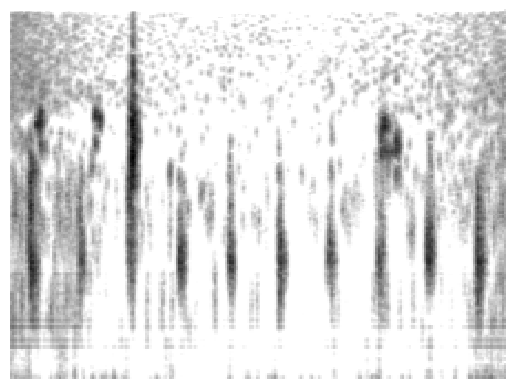

In [ ]:
img = cv2.imread(test_img)
cv2_imshow(img)

1/1 [==============================] - 0s 141ms/step

##########################################
CNN from scratch:  barswa 0.7590571
VGG16:  barswa 0.9858283
MobileNetV2:  barswa 0.69835967
ResNet50:  barswa 0.9873006
##########################################



<ipython-input-15-dc4b262c8a67>:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


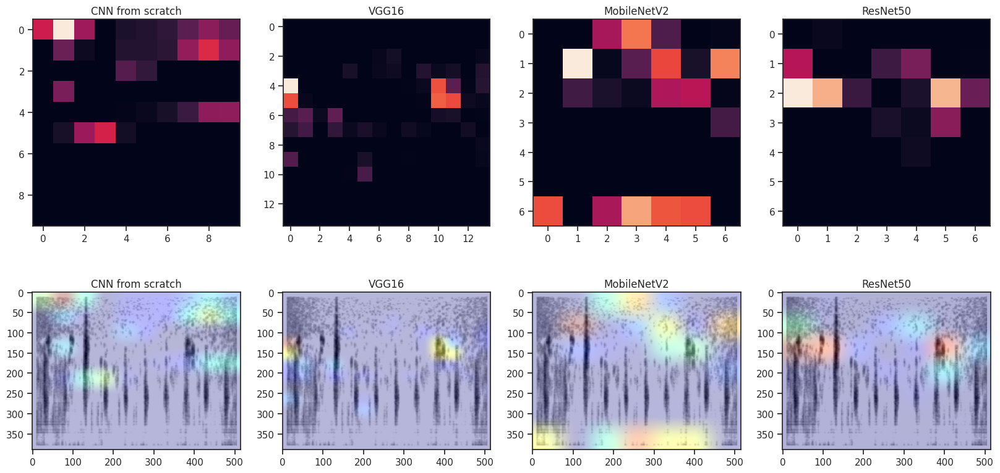

In [ ]:
heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam = calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50)
print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam)

##thrnig1

In [ ]:
test_img = os.path.join(TEST_PATH, 'thrnig1/XC660166_38.png')
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/thrnig1/XC660166_38.png


In [ ]:
img_array = get_img_array(test_img, target_size=(224, 224))
scratch_predictions = cnn_scratch.predict(img_array)
heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
vgg16_predictions = vgg16.predict(img_array)
heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
mobilenetv2_predictions = mobilenetv2.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
resnet50_predictions = resnet50.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 1)

1/1 [==============================] - 0s 329ms/step


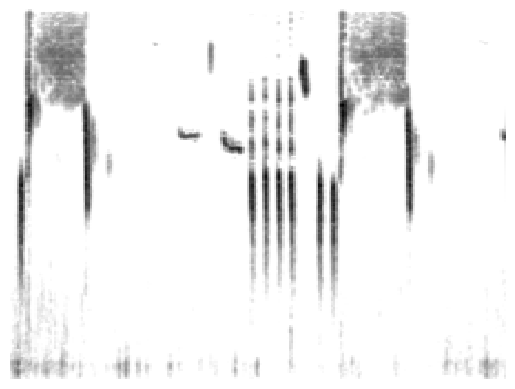

In [ ]:
img = cv2.imread(test_img)
cv2_imshow(img)

1/1 [==============================] - 0s 123ms/step

##########################################
CNN from scratch:  thrnig1 0.9865307
VGG16:  thrnig1 0.98563147
MobileNetV2:  thrnig1 0.82135653
ResNet50:  thrnig1 0.9998474
##########################################



<ipython-input-15-dc4b262c8a67>:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


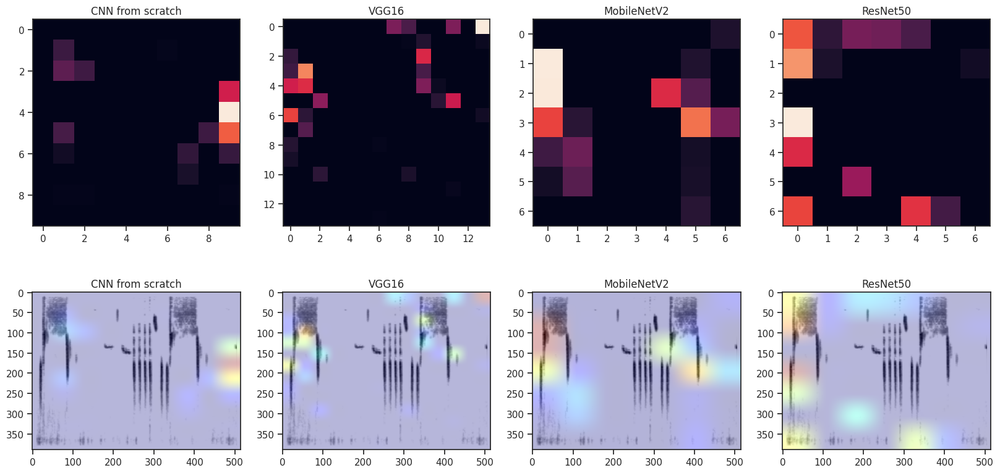

In [ ]:
heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam = calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50)
print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam)

##amesun2

In [ ]:
test_img = os.path.join(TEST_PATH, 'amesun2/XC292886_0.png')
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/amesun2/XC292886_0.png


In [ ]:
img_array = get_img_array(test_img, target_size=(224, 224))
scratch_predictions = cnn_scratch.predict(img_array)
heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
vgg16_predictions = vgg16.predict(img_array)
heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
mobilenetv2_predictions = mobilenetv2.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
resnet50_predictions = resnet50.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 1)

1/1 [==============================] - 0s 122ms/step


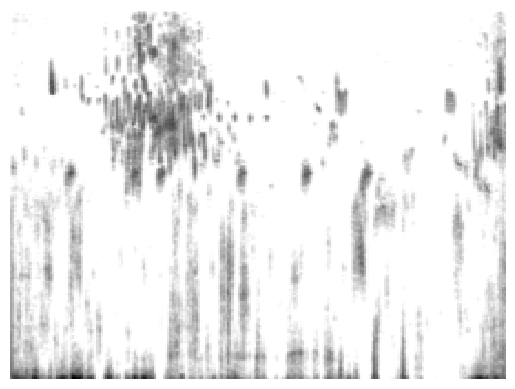

In [ ]:
img = cv2.imread(test_img)
cv2_imshow(img)

1/1 [==============================] - 0s 120ms/step

##########################################
CNN from scratch:  amesun2 0.108481705
VGG16:  amesun2 0.6536937
MobileNetV2:  amesun2 0.1858292
ResNet50:  amesun2 0.48802182
##########################################



<ipython-input-15-dc4b262c8a67>:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


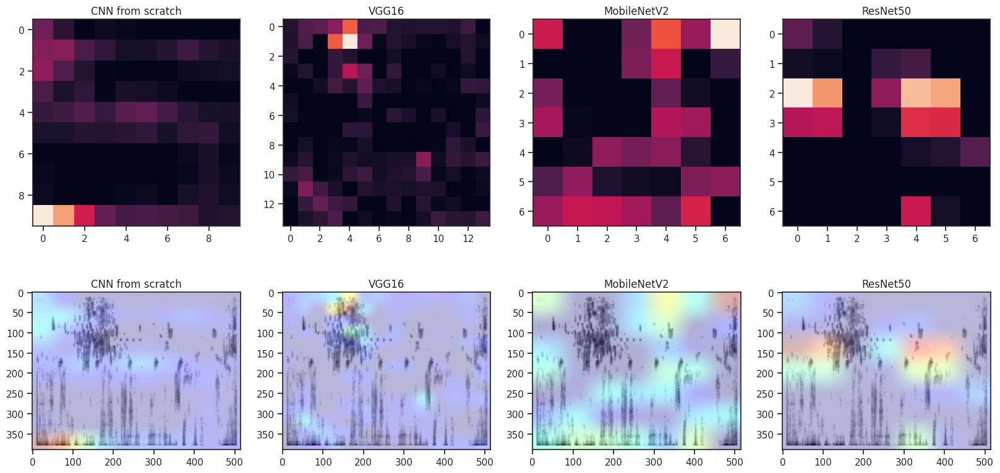

In [ ]:
heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam = calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50)
print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam)

##grbcam1

In [ ]:
test_img = os.path.join(TEST_PATH, 'grbcam1/XC412168_3.png')
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/grbcam1/XC412168_3.png


In [ ]:
img_array = get_img_array(test_img, target_size=(224, 224))
scratch_predictions = cnn_scratch.predict(img_array)
heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
vgg16_predictions = vgg16.predict(img_array)
heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
mobilenetv2_predictions = mobilenetv2.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
resnet50_predictions = resnet50.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 1)

1/1 [==============================] - 0s 121ms/step


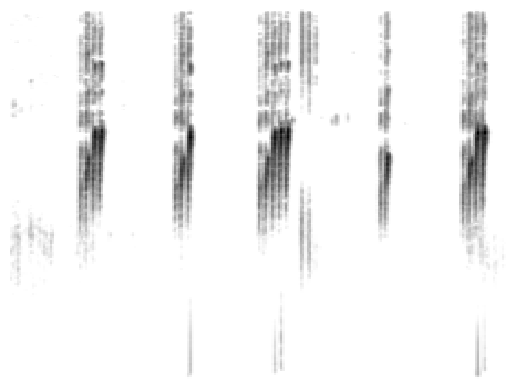

In [ ]:
img = cv2.imread(test_img)
cv2_imshow(img)

1/1 [==============================] - 0s 127ms/step

##########################################
CNN from scratch:  grbcam1 0.47354543
VGG16:  grbcam1 0.99858475
MobileNetV2:  grbcam1 0.2989202
ResNet50:  grbcam1 0.9954007
##########################################



<ipython-input-15-dc4b262c8a67>:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


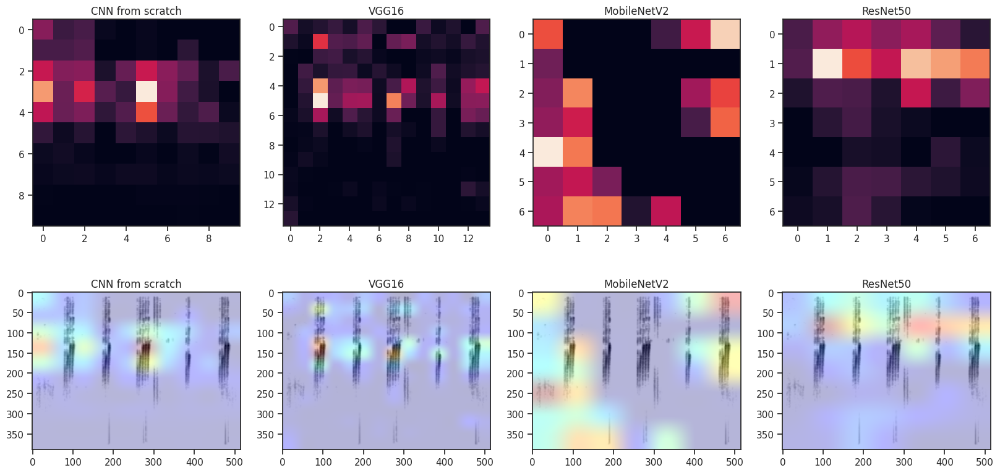

In [ ]:
heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam = calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50)
print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam)

##Random images

In [ ]:
import os, random
label = 'grbcam1'
test_files = os.listdir(os.path.join(TEST_PATH, label))
r = random.choice(test_files)
r

'XC412168_3.png'

In [ ]:
test_img = os.path.join(TEST_PATH, label, r)
print(test_img)

/content/drive/.shortcut-targets-by-id/1pfBa0fnatsy0qYLtZ2wpGwzSR-zOPP2W/CIDL project/birds/dataset/test/grbcam1/XC412168_3.png


In [ ]:
img_array = get_img_array(test_img, target_size=(224, 224))
scratch_predictions = cnn_scratch.predict(img_array)
heatmap_scratch = make_heatmap(img_array, cnn_scratch, get_last_conv_layer_index(cnn_scratch), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
vgg16_predictions = vgg16.predict(img_array)
heatmap_vgg16 = make_heatmap(img_array, vgg16, get_last_conv_layer_index(vgg16), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
mobilenetv2_predictions = mobilenetv2.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, mobilenetv2, get_last_conv_layer_index(mobilenetv2), 1)

img_array = get_img_array(test_img, target_size=(224, 224))
resnet50_predictions = resnet50.predict(img_array)
heatmap_resnet101 = make_heatmap(img_array, resnet50, get_last_conv_layer_index(resnet50), 1)

1/1 [==============================] - 0s 175ms/step


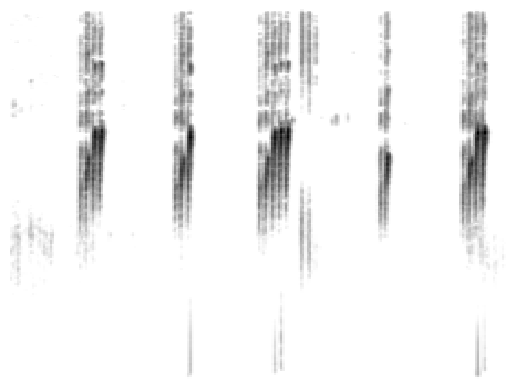

In [ ]:
img = cv2.imread(test_img)
cv2_imshow(img)

1/1 [==============================] - 0s 125ms/step

##########################################
CNN from scratch:  grbcam1 0.47354543
VGG16:  grbcam1 0.99858475
MobileNetV2:  grbcam1 0.2989202
ResNet50:  grbcam1 0.9954007
##########################################



<ipython-input-15-dc4b262c8a67>:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


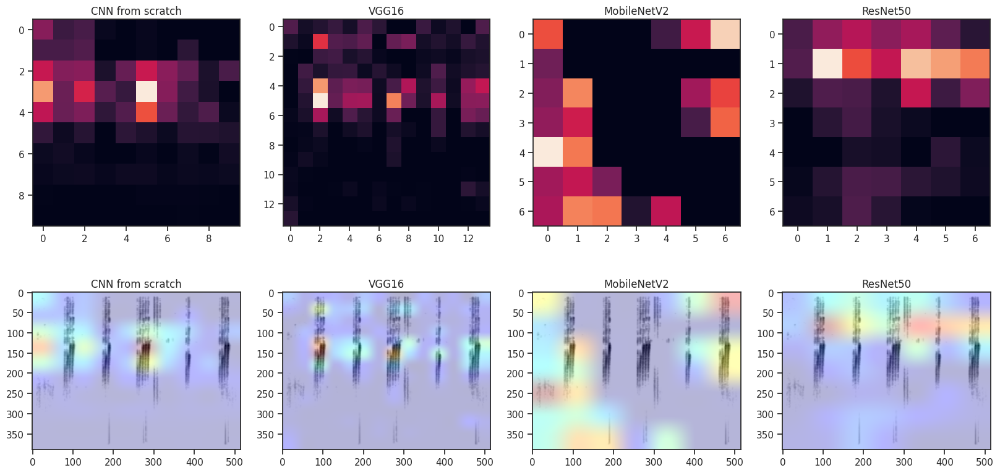

In [ ]:
heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam = calculate_heatmaps(test_img, cnn_scratch, vgg16, mobilenetv2, resnet50)
print_heatmaps(heatmap_scratch, heatmap_vgg16, heatmap_mobilenetv2, heatmap_resnet50, scratch_gradcam, vgg16_gradcam, mobilenetv2_gradcam, resnet50_gradcam)